<a href="https://colab.research.google.com/github/tonylents/DS-Unit-1-Sprint-1-Data-Wrangling-and-Storytelling/blob/master/Anton_Lents_SF_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##1. Uploading and cleaning

In [0]:
# Import the libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
# Import the data

# Library for uploading files manually
from google.colab import files

uploaded=files.upload()

Saving test.csv to test.csv


In [3]:
df=pd.read_csv('test.csv')
print(df.shape)
df

(884262, 7)


,Id,Dates,DayOfWeek,PdDistrict,Address,X,Y
0,0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051
1,1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432
2,2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212
3,3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412
4,4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412
...,...,...,...,...,...,...,...
884257,884257,2003-01-01 00:01:00,Wednesday,MISSION,2600 Block of BRYANT ST,-122.408983,37.751987
884258,884258,2003-01-01 00:01:00,Wednesday,NORTHERN,1900 Block of WASHINGTON ST,-122.425342,37.792681
884259,884259,2003-01-01 00:01:00,Wednesday,INGLESIDE,5500 Block of MISSION ST,-122.445418,37.712075
884260,884260,2003-01-01 00:01:00,Wednesday,BAYVIEW,1500 Block of HUDSON AV,-122.387394,37.739479


In [0]:
#converting date cleared to date time
df['Dates'] = pd.to_datetime(df['Dates'])

In [5]:
# Check for missing data
df.isnull().sum()

Id            0
Dates         0
DayOfWeek     0
PdDistrict    0
Address       0
X             0
Y             0
dtype: int64

In [6]:
df.dtypes

Id                     int64
Dates         datetime64[ns]
DayOfWeek             object
PdDistrict            object
Address               object
X                    float64
Y                    float64
dtype: object

In [7]:
# Cool, no missing data so far.
# But looks like 'id' column is unnecessary, so let's drop it
df = df.drop(['Id'], axis=1)
print(df.shape)
df.head()

(884262, 6)


,Dates,DayOfWeek,PdDistrict,Address,X,Y
0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051
1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432
2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212
3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412
4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412


##2. Analysis

###2.1. Crimes by days

In [8]:
# Let's count all the crimes for different days of the week
df['DayOfWeek'].value_counts()#(normalize=True)

Friday       134703
Wednesday    130399
Saturday     127038
Tuesday      126940
Thursday     126541
Monday       122226
Sunday       116415
Name: DayOfWeek, dtype: int64

In [9]:
# Check if the numbers match the amount
df['DayOfWeek'].value_counts().sum()

884262

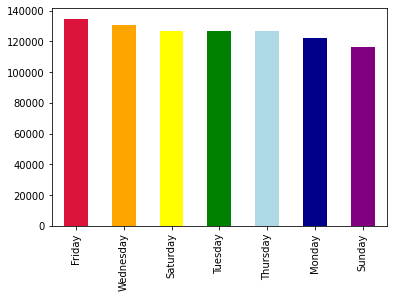

In [10]:
# Quick visualisation
df['DayOfWeek'].value_counts().plot(kind='bar', color=['crimson', 'orange', 'yellow', 'green','lightblue','darkblue','purple']);

Apparently, there is a spike on Fridays and Wednesdays

In [11]:
pd.DataFrame(df['DayOfWeek'].value_counts())

,DayOfWeek
Friday,134703
Wednesday,130399
Saturday,127038
Tuesday,126940
Thursday,126541
Monday,122226
Sunday,116415


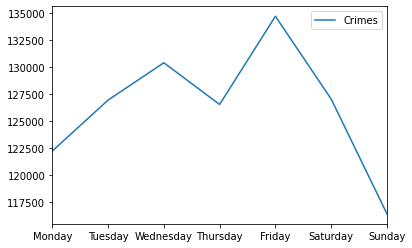

In [12]:
# Visualization of crimes in different days of a week
index_dow=['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday']
data_dow=np.array([122226,126940,130399,126541,134703,127038,116415])
column_headers_dow=['Crimes']
days_of_week=pd.DataFrame(data=data_dow,index=index_dow,columns=column_headers_dow)
days_of_week.plot();

In [13]:
# What about neighborhoods?..
df['PdDistrict'].value_counts()#(normalize=True)

SOUTHERN      157456
MISSION       120449
NORTHERN      107017
BAYVIEW        89591
CENTRAL        86130
TENDERLOIN     81747
INGLESIDE      80084
TARAVAL        66617
PARK           50199
RICHMOND       44972
Name: PdDistrict, dtype: int64

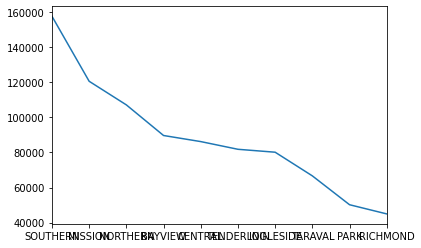

In [14]:
df['PdDistrict'].value_counts().plot();

####For visualizations

In [0]:
# Plotly imports
import plotly
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, plot, iplot

In [0]:
# Function for colab:
def enable_plotly_in_cell():
    import IPython
    from plotly.offline import init_notebook_mode
    display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
    init_notebook_mode(connected=False)

###2.2. Police districts

In [18]:
df_short=df[(df['DayOfWeek'] == 'Friday')]
print(df_short.shape)
df_short.head()

(134703, 6)


,Dates,DayOfWeek,PdDistrict,Address,X,Y
704,2015-05-08 23:59:00,Friday,INGLESIDE,1100 Block of GOETTINGEN ST,-122.402885,37.717831
705,2015-05-08 23:45:00,Friday,CENTRAL,1300 Block of STOCKTON ST,-122.408647,37.798117
706,2015-05-08 23:45:00,Friday,CENTRAL,1300 Block of STOCKTON ST,-122.408647,37.798117
707,2015-05-08 23:45:00,Friday,MISSION,2000 Block of MISSION ST,-122.419658,37.764221
708,2015-05-08 23:45:00,Friday,NORTHERN,3200 Block of FILLMORE ST,-122.436072,37.799622


In [19]:
import plotly.express as px
fig = px.scatter_mapbox(df_short, lat='Y', lon='X', color='PdDistrict', opacity=1.0)
fig.update_layout(mapbox_style='stamen-terrain')
fig.show()

###2.3. Separations by Daytime and Years

In [20]:
df['Time']=df['Dates'].dt.time
print(df.shape)
df.head()

(884262, 7)


,Dates,DayOfWeek,PdDistrict,Address,X,Y,Time
0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051,23:59:00
1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432,23:51:00
2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212,23:50:00
3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00
4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00


In [0]:
def day_time(time):
    if time.hour >= 6 and time.hour < 12:
        return "Morning" 
    elif time.hour >= 12 and time.hour < 18:
        return "Afternoon" 
    elif time.hour >= 18 and time.hour < 22:
        return "Evening"
    else:
        return "Night"

In [22]:
# Create a new column with categorical time of a day
df['DayTime']=df['Time'].transform(day_time)
print(df.shape)
df.head()

(884262, 8)


,Dates,DayOfWeek,PdDistrict,Address,X,Y,Time,DayTime
0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051,23:59:00,Night
1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432,23:51:00,Night
2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212,23:50:00,Night
3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00,Night
4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00,Night


In [23]:
# Separate df by years
year_df=df
year_df['Year']=df['Dates'].dt.year
print(year_df.shape)
year_df.head()

(884262, 9)


,Dates,DayOfWeek,PdDistrict,Address,X,Y,Time,DayTime,Year
0,2015-05-10 23:59:00,Sunday,BAYVIEW,2000 Block of THOMAS AV,-122.399588,37.735051,23:59:00,Night,2015
1,2015-05-10 23:51:00,Sunday,BAYVIEW,3RD ST / REVERE AV,-122.391523,37.732432,23:51:00,Night,2015
2,2015-05-10 23:50:00,Sunday,NORTHERN,2000 Block of GOUGH ST,-122.426002,37.792212,23:50:00,Night,2015
3,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00,Night,2015
4,2015-05-10 23:45:00,Sunday,INGLESIDE,4700 Block of MISSION ST,-122.437394,37.721412,23:45:00,Night,2015


In [24]:
# New df (2015)
df_2015=year_df
df_2015=year_df[(year_df['Year'] == 2015)]
df_2015=df_2015.drop(['Dates','DayOfWeek','PdDistrict','Address','Time','Year'], axis=1)
print(df_2015.shape)
df_2015.head()

(28431, 3)


,X,Y,DayTime
0,-122.399588,37.735051,Night
1,-122.391523,37.732432,Night
2,-122.426002,37.792212,Night
3,-122.437394,37.721412,Night
4,-122.437394,37.721412,Night


In [62]:
# New df (2008)
df_2008=year_df
df_2008=year_df[(year_df['Year'] == 2008)]
df_2008=df_2008.drop(['Dates','DayOfWeek','Address','Time','Year','X','Y','DayTime'], axis=1)
print(df_2008.shape)
df_2008.head()

(71137, 2)


,PdDistrict,Day
454148,SOUTHERN,2008-12-31
454149,SOUTHERN,2008-12-31
454150,SOUTHERN,2008-12-31
454151,SOUTHERN,2008-12-31
454152,SOUTHERN,2008-12-31


In [25]:
# Visualization (2015)
fig = px.scatter_mapbox(df_2015, lat='Y', lon='X', color='DayTime', opacity=1.0)
fig.update_layout(mapbox_style='stamen-terrain')
fig.show()

In [26]:
# 2015
df_2015['DayTime'].value_counts()#.plot();

Afternoon    9251
Evening      6942
Night        6768
Morning      5470
Name: DayTime, dtype: int64

In [0]:
# Settings for donut chart
myheading = "What's your favorite Dunkin' Donut?"
mytitle = "Crimes by day time"
mylabels = ['Afternoon', 'Evening', 'Night','Morning']
myvalues = [9251,6942,6768,5470]
color1 = 'e11383'
color2 = 'f5821f'
color3 = '683817'
color4 = 'crimson'

In [52]:
enable_plotly_in_cell()
########### Set up the chart
mydata = go.Pie(labels = mylabels,
                values = myvalues,
                hole = 0.5,
                sort=False,
                marker = {'colors':[color1, color2, color3,color4],
                          'line': {'color':'white',
                                   'width': 5}})
mylayout = go.Layout(title=mytitle)
go.Figure([mydata], mylayout).show()

In [29]:
# Create a special df for visualization
daytime_df=year_df.drop(['Dates','DayOfWeek','PdDistrict','Address','Time'], axis=1)
print(year_df.shape)
night_df=daytime_df[(daytime_df['DayTime'] == 'Night')]
print(night_df.shape)
night_df.head()

(884262, 9)
(215942, 4)


,X,Y,DayTime,Year
0,-122.399588,37.735051,Night,2015
1,-122.391523,37.732432,Night,2015
2,-122.426002,37.792212,Night,2015
3,-122.437394,37.721412,Night,2015
4,-122.437394,37.721412,Night,2015


In [53]:
# Visualization (night)
fig = px.scatter_mapbox(night_df, lat='Y', lon='X', color='DayTime', opacity=1.0)
fig.update_layout(mapbox_style='stamen-terrain')
fig.show()

In [31]:
columns_den=['Date','Crimes']
den_df=pd.DataFrame(columns=columns_den)
den_df

,Date,Crimes


In [32]:
# New df (2015)
df_2015t=year_df
df_2015t=year_df[(year_df['Year'] == 2015)]
df_2015t=df_2015t.drop(['Dates','DayOfWeek','X','Y','Address','DayTime','Year'], axis=1)
print(df_2015t.shape)
df_2015t.head()

(28431, 2)


,PdDistrict,Time
0,BAYVIEW,23:59:00
1,BAYVIEW,23:51:00
2,NORTHERN,23:50:00
3,INGLESIDE,23:45:00
4,INGLESIDE,23:45:00


In [33]:
import plotly.express as px
px.scatter(df_2015t,x='PdDistrict',y='Time')

In [34]:
# Separate df by years
tosum_df=df
tosum_df['Day']=df['Dates'].dt.date
tosum_df=tosum_df.drop(['Dates','DayOfWeek','Address','DayTime','Year','Time','X','Y'], axis=1)
print(tosum_df.shape)
tosum_df.head()

(884262, 2)


,PdDistrict,Day
0,BAYVIEW,2015-05-10
1,BAYVIEW,2015-05-10
2,NORTHERN,2015-05-10
3,INGLESIDE,2015-05-10
4,INGLESIDE,2015-05-10


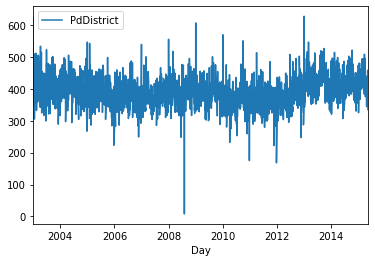

In [35]:
tosum_df.groupby(['Day']).count().plot();
  

In [43]:
count_df=tosum_df.groupby(['Day']).count()
count_df.reset_index('Day', drop=False, inplace=True)
count_df=count_df.rename(columns={"PdDistrict": "CrimesAmount"})
count_df

,Day,CrimesAmount
0,2003-01-01,622
1,2003-01-02,411
2,2003-01-03,440
3,2003-01-04,347
4,2003-01-05,377
...,...,...
2261,2015-05-06,421
2262,2015-05-07,458
2263,2015-05-08,424
2264,2015-05-09,369


In [63]:
count_2008=df_2008.groupby(['Day']).count()
count_2008.reset_index('Day', drop=False, inplace=True)
count_2008=count_2008.rename(columns={"PdDistrict": "CrimesAmount"})
count_2008

,Day,CrimesAmount
0,2008-01-01,555
1,2008-01-02,394
2,2008-01-03,387
3,2008-01-04,362
4,2008-01-05,351
...,...,...
179,2008-12-20,458
180,2008-12-21,336
181,2008-12-29,375
182,2008-12-30,387


In [66]:
import plotly.express as px
fig = px.scatter(count_2008, x="Day", y="CrimesAmount")
fig.show()
#px.scatter(count_2008,x='Day',y='CrimesAmount');